In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns


## QQ plot of pairwise pvalues for trans-eqtl and null snps

In [5]:
chr7_pairwise = pd.read_csv('/storage/polo/GTEx_v8_matrix_eQTL/run2_GTEx_v8_Euro_only_PEER/Thyroid_Euro/chr7_matrixeQTL_raw.tsv.gz', sep='\t')

In [6]:
chr7_pairwise

,SNP,gene,beta,t-stat,p-value,FDR
0,chr7_44107886,ENSG00000204160.11,3.338121e-01,5.431930e+00,8.875908e-08,1.0
1,chr7_130368444,ENSG00000117400.16,-4.002415e-01,-5.249764e+00,2.291572e-07,1.0
2,chr7_77355255,ENSG00000185028.3,-3.626551e-01,-5.227161e+00,2.572948e-07,1.0
3,chr7_12351693,ENSG00000043591.5,3.071145e-01,5.150984e+00,3.789820e-07,1.0
4,chr7_93486987,ENSG00000165060.11,3.161029e-01,5.132545e+00,4.159287e-07,1.0
...,...,...,...,...,...,...
19148959,chr7_87171035,ENSG00000160683.4,-2.232954e-08,-2.235056e-07,9.999998e-01,1.0
19148960,chr7_120788745,ENSG00000113580.14,1.577307e-08,2.062392e-07,9.999998e-01,1.0
19148961,chr7_50368079,ENSG00000113649.11,-1.041957e-08,-1.648992e-07,9.999999e-01,1.0
19148962,chr7_39339726,ENSG00000136100.12,-1.036283e-08,-1.108869e-07,9.999999e-01,1.0


In [73]:
chr7_pairwise_matrix = pd.read_csv('/storage/cynthiawu/trans_eQTL/GTex.v8/Run2_031621/Nerve_Tibial/chr7/gene-snp_eqtls_pvalue_chr7', sep='\t')


In [74]:
pvalues_hit = np.array(chr7_pairwise_matrix[chr7_pairwise_matrix['SNP']=='chr7_45109068'])[0][1:]


In [24]:
pvalues_hit

array([0.0368588600297378, 0.189285900846314, 0.0159657569617045, ...,
       0.268387104751981, 0.128495778448456, 0.29234249729885703],
      dtype=object)

Text(0.5, 1.0, 'pvalues of genes for chr7_45109068 hit, uniform dist')

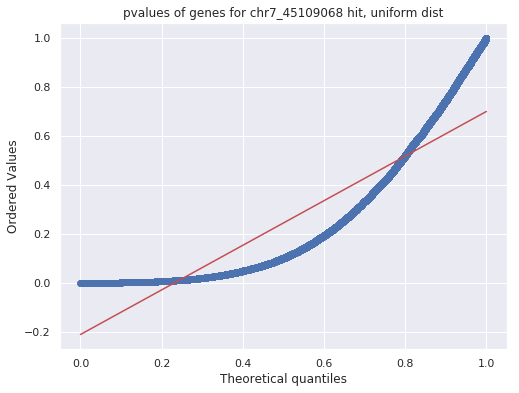

In [79]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
stats.probplot(list(pvalues_hit), dist='uniform', plot=ax)
plt.title('pvalues of genes for chr7_45109068 hit, uniform dist')


In [43]:
stats.kstest(list(pvalues_hit), 'uniform')

KstestResult(statistic=0.41060507584630435, pvalue=0.0)

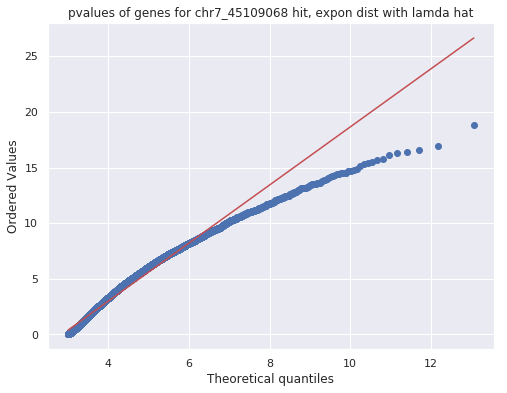

In [81]:
pvalues = -np.log(list(pvalues_hit))
max_lklh = 1 / np.mean(pvalues)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
stats.probplot(pvalues, dist='expon', sparams=(1/max_lklh), plot=ax)
plt.title('pvalues of genes for chr7_45109068 hit, expon dist with lamda hat')

pass

In [45]:
stats.kstest(pvalues, 'expon')

KstestResult(statistic=0.41060507584630435, pvalue=0.0)

In [46]:
?stats.kstest

In [83]:
pvalues_null = np.array(chr7_pairwise_matrix[chr7_pairwise_matrix['SNP']=='chr7_12354340'])[0][1:]


Text(0.5, 1.0, 'pvalues of genes for a null snp, uniform dist')

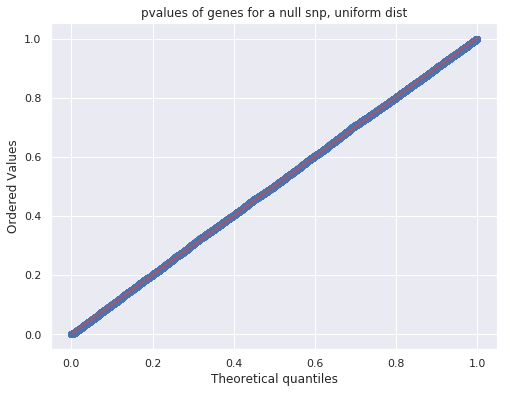

In [84]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
stats.probplot(list(pvalues_null), dist='uniform', plot=ax)
plt.title('pvalues of genes for a null snp, uniform dist')


In [42]:
stats.kstest(list(pvalues_null), 'uniform')

KstestResult(statistic=0.007696579358806188, pvalue=0.2852393337744029)

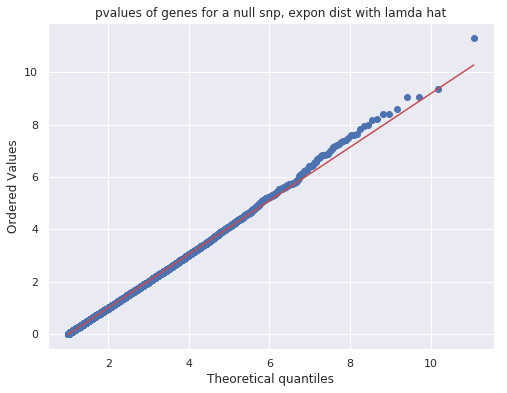

In [85]:
pvalues = -np.log(list(pvalues_null))
max_lklh = 1 / np.mean(pvalues)

fig = plt.figure(figsize=(8, 6))

ax = fig.add_subplot(111)
stats.probplot(pvalues, dist='expon', sparams=(1/max_lklh), plot=ax)
plt.title('pvalues of genes for a null snp, expon dist with lamda hat')

pass

In [30]:
pvalues_hit_before = np.array(chr7_pairwise_matrix[chr7_pairwise_matrix['SNP']=='chr7_45082865'])[0][1:]


Text(0.5, 1.0, 'pvalues of target genes')

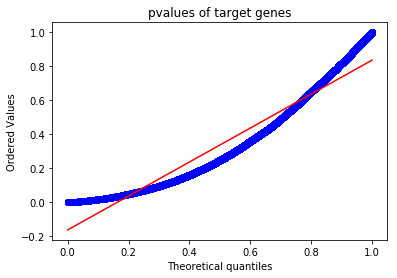

In [31]:
fig = plt.figure()
ax = fig.add_subplot(111)
stats.probplot(list(pvalues_hit_before), dist='uniform', plot=ax)
plt.title('pvalues of target genes')


## Clustering by genotype for chr7_45109068 vs expression

In [49]:
expression = pd.read_csv('/storage/polo/GTEx_v8_matrix_eQTL/run2_GTEx_v8_Euro_only_PEER/Nerve-Tibial_Euro/chr7_gene_intersect.tsv', sep='\t', index_col='id')
genotype = pd.read_csv('/storage/polo/GTEx_v8_matrix_eQTL/run2_GTEx_v8_Euro_only_PEER/Nerve-Tibial_Euro/chr7_SNP_intersect.tsv', sep='\t')

In [4]:
chr7_pairwise_matrix = pd.read_csv('/storage/cynthiawu/trans_eQTL/GTex.v8/Run2_031621/Nerve_Tibial/chr7/gene-snp_eqtls_pvalue_chr7', sep='\t')


In [72]:
expression

,GTEX-111CU,GTEX-111FC,GTEX-111VG,GTEX-111YS,GTEX-1192X,GTEX-11DXX,GTEX-11EI6,GTEX-11EQ9,GTEX-11GS4,GTEX-11GSO,...,GTEX-ZVE2,GTEX-ZVT3,GTEX-ZVZP,GTEX-ZXES,GTEX-ZXG5,GTEX-ZYFD,GTEX-ZYFG,GTEX-ZYT6,GTEX-ZYVF,GTEX-ZZ64
id,,,,,,,,,,,,,,,,,,,,,
ENSG00000186092.4,0.048259,0.019160,-0.145478,0.171940,-0.049842,0.030037,-0.077296,-0.072639,-0.000505,-0.013284,...,-0.080438,0.124874,-0.056003,-0.047055,-0.123918,0.014669,-0.094478,0.040640,-0.144561,-0.038531
ENSG00000187634.11,-2.645998,-1.876636,-1.041262,-1.908307,0.048825,-0.644641,-2.303968,-0.078533,0.011340,0.787927,...,-1.600266,1.925487,0.668566,0.270199,0.803839,-0.780666,0.210454,-3.867660,-1.035812,0.031481
ENSG00000188976.10,-8.864655,-3.061615,-0.023590,-5.626869,11.074631,-7.279373,1.178162,-3.749825,0.371113,1.224190,...,-5.852894,7.752342,-10.181099,-4.575611,-9.051497,-6.944416,-1.281609,-0.840725,12.674637,7.020851
ENSG00000187961.13,1.594158,-0.143692,-0.229895,0.406779,-0.617736,0.555145,0.048167,0.632092,-0.003895,0.834848,...,2.668459,0.362275,-1.792283,0.040382,-0.990067,0.099062,-0.655231,0.073309,3.525727,-0.318599
ENSG00000187583.10,0.069548,0.038110,0.394435,-0.018386,-0.221099,-0.181189,0.460650,-0.117168,0.002865,0.203060,...,0.010855,-0.370534,-0.002716,0.080500,0.115328,0.016502,-0.152155,0.112124,0.051081,0.216364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000212907.2,12158.952148,8772.957031,7278.111328,14478.851562,6471.020508,5266.373535,5660.943848,10338.910156,6264.531738,7317.895996,...,12188.894531,8608.920898,10509.020508,12418.894531,4009.044922,14078.812500,10658.995117,11168.945312,3887.764648,11068.799805
ENSG00000198886.2,26393.832031,25573.941406,20653.947266,33263.847656,16303.865234,14543.911133,16783.900391,26983.861328,16835.619141,16803.892578,...,29683.847656,21803.923828,32673.878906,29053.853516,18913.929688,30613.863281,32483.865234,27303.900391,10563.704102,26233.802734
ENSG00000198786.2,3352.301270,302.685059,1221.039551,3328.313965,-820.107178,-477.227295,-518.676025,2265.787109,-232.878418,-476.488770,...,698.493896,2619.961182,1742.907715,3759.396240,-560.281250,5240.904297,2160.572998,851.665527,-845.039551,2748.766113


In [86]:
genotype

,id,GTEX-111CU,GTEX-111FC,GTEX-111VG,GTEX-111YS,GTEX-1192X,GTEX-11DXX,GTEX-11EI6,GTEX-11EQ9,GTEX-11GS4,...,GTEX-ZVE2,GTEX-ZVT3,GTEX-ZVZP,GTEX-ZXES,GTEX-ZXG5,GTEX-ZYFD,GTEX-ZYFG,GTEX-ZYT6,GTEX-ZYVF,GTEX-ZZ64
0,chr7_246436,0,0,1,1,1,1,0,0,0,...,0,1,2,0,0,1,1,0,0,0
1,chr7_259884,0,0,0,0,0,0,1,1,2,...,2,1,0,2,0,0,1,2,1,1
2,chr7_259974,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,1,0,0,0
3,chr7_291120,0,0,2,1,2,1,1,0,2,...,1,2,0,0,1,1,2,2,1,1
4,chr7_291253,0,0,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1117,chr7_158879928,0,1,1,1,0,0,1,1,1,...,2,2,0,0,0,0,1,0,1,1
1118,chr7_158922528,2,1,2,2,2,2,1,1,1,...,1,0,2,2,2,2,2,2,1,1
1119,chr7_158942122,1,0,1,1,0,1,0,0,0,...,1,0,0,0,0,0,0,0,0,0
1120,chr7_159034635,1,0,0,2,0,0,0,0,0,...,0,1,0,0,1,0,0,1,0,0


In [5]:
genotype_hit = genotype[genotype['id']=='chr7_45109068']
genotype_hit = genotype_hit.set_index(['id'])
genotype_hit.sort_values(by='chr7_45109068', axis=1)

,GTEX-QDVJ,GTEX-WL46,GTEX-1EH9U,GTEX-WOFM,GTEX-1E1VI,GTEX-1CB4J,GTEX-WRHU,GTEX-1CB4H,GTEX-WVLH,GTEX-1CB4F,...,GTEX-XMK1,GTEX-1MJK3,GTEX-ZT9X,GTEX-ZP4G,GTEX-1K9T9,GTEX-1GMRU,GTEX-1QPFJ,GTEX-1F5PK,GTEX-1B97I,GTEX-T6MO
id,,,,,,,,,,,,,,,,,,,,,
chr7_45109068,0,0,0,0,0,0,0,0,0,0,...,2,2,2,2,2,2,2,2,2,2


In [42]:
genotype_hit['GTEX-QDVJ']['chr7_45109068']

0

In [12]:
# column_cluster_rename = genotype_hit.rename(columns = lambda x: x +'_' + str(genotype_hit[x]['chr7_45109068'])).sort_values(by='chr7_45109068', axis=1)

In [16]:
column_order = genotype_hit.sort_values(by='chr7_45109068', axis=1).columns
expression_clustered = expression[column_order]
expression_clustered = expression_clustered.rename(columns = lambda x: x +'_' + str(genotype_hit[x]['chr7_45109068']))
expression_clustered_std = expression_clustered.copy().T
# apply the z-score method
for column in expression_clustered_std.columns:
    expression_clustered_std[column] = (expression_clustered_std[column] - expression_clustered_std[column].mean()) / expression_clustered_std[column].std()

In [19]:
expression_clustered_std.index

Index(['GTEX-QDVJ_0', 'GTEX-WL46_0', 'GTEX-1EH9U_0', 'GTEX-WOFM_0',
       'GTEX-1E1VI_0', 'GTEX-1CB4J_0', 'GTEX-WRHU_0', 'GTEX-1CB4H_0',
       'GTEX-WVLH_0', 'GTEX-1CB4F_0',
       ...
       'GTEX-XMK1_2', 'GTEX-1MJK3_2', 'GTEX-ZT9X_2', 'GTEX-ZP4G_2',
       'GTEX-1K9T9_2', 'GTEX-1GMRU_2', 'GTEX-1QPFJ_2', 'GTEX-1F5PK_2',
       'GTEX-1B97I_2', 'GTEX-T6MO_2'],
      dtype='object', length=449)

In [63]:
color_dict = {}
geno_0 = []
geno_1 = []
geno_2 = []
for sample in expression_clustered_std.index:
    geno = sample[-1]    
    if geno == '0':
        color_dict[sample] = 'r'
        geno_0.append(sample)
    if geno == '1':
        color_dict[sample] = 'b'
        geno_1.append(sample)

    if geno == '2':
        color_dict[sample] = 'g'
        geno_2.append(sample)


In [33]:
color_rows = pd.Series(color_dict)
color_rows.head()

GTEX-QDVJ_0     r
GTEX-WL46_0     r
GTEX-1EH9U_0    r
GTEX-WOFM_0     r
GTEX-1E1VI_0    r
dtype: object

In [7]:
pvalues_hit = chr7_pairwise_matrix[chr7_pairwise_matrix['SNP']=='chr7_45109068']
pvalues_hit = pvalues_hit.set_index(['SNP'])

In [15]:
pvalues_hit.sort_values(by='chr7_45109068', axis=1)

,ENSG00000198938.2,ENSG00000179163.11,ENSG00000170248.13,ENSG00000185722.16,ENSG00000165322.17,ENSG00000166233.14,ENSG00000166887.15,ENSG00000138592.13,ENSG00000139719.9,ENSG00000134086.7,...,ENSG00000164188.8,ENSG00000159374.17,ENSG00000161652.12,ENSG00000179292.4,ENSG00000138271.5,ENSG00000163288.13,ENSG00000157884.10,ENSG00000171931.12,ENSG00000164484.11,ENSG00000010219.13
SNP,,,,,,,,,,,,,,,,,,,,,
chr7_45109068,6.803445e-09,4.575546e-08,6.363186e-08,7.365275e-08,8.596322e-08,9.518670e-08,1.420462e-07,1.535922e-07,1.863865e-07,1.982057e-07,...,0.998105,0.998343,0.99837,0.998434,0.998613,0.999064,0.999583,0.999692,0.9997,0.999798


In [8]:
tophits = pvalues_hit.sort_values(by='chr7_45109068', axis=1).columns[:1000]
nullhits = pvalues_hit.sort_values(by='chr7_45109068', ascending=False, axis=1).columns[:1000]

In [11]:
pvalues_hit

,SNP,ENSG00000000003.14,ENSG00000000005.5,ENSG00000000419.12,ENSG00000000457.13,ENSG00000000460.16,ENSG00000000938.12,ENSG00000000971.15,ENSG00000001036.13,ENSG00000001084.10,...,ENSG00000283654.1,ENSG00000283755.1,ENSG00000283787.1,ENSG00000283886.1,ENSG00000283992.1,ENSG00000284024.1,ENSG00000284308.1,ENSG00000284395.1,ENSG00000284484.1,ENSG00000284526.1
815,chr7_45109068,0.036859,0.189286,0.015966,0.019929,0.010115,0.704596,0.603665,0.012695,0.675352,...,0.738351,0.575491,0.207958,0.045071,0.17617,0.006641,0.029921,0.268387,0.128496,0.292342


In [29]:
nullhits

Index(['ENSG00000010219.13', 'ENSG00000164484.11', 'ENSG00000171931.12',
       'ENSG00000157884.10', 'ENSG00000163288.13', 'ENSG00000138271.5',
       'ENSG00000179292.4', 'ENSG00000161652.12', 'ENSG00000159374.17',
       'ENSG00000164188.8',
       ...
       'ENSG00000131746.12', 'ENSG00000134533.6', 'ENSG00000167552.13',
       'ENSG00000185972.5', 'ENSG00000146038.11', 'ENSG00000102181.20',
       'ENSG00000256061.7', 'ENSG00000149418.10', 'ENSG00000135951.14',
       'ENSG00000189060.5'],
      dtype='object', length=1000)

In [17]:
expression_clustered_tophits = expression_clustered_std.T.reindex(tophits)
expression_clustered_nullhits = expression_clustered_std.T.reindex(nullhits)

In [67]:
expression_clustered_tophits_geno0 = expression_clustered_tophits[geno_0]
expression_clustered_tophits_geno1 = expression_clustered_tophits[geno_1]
expression_clustered_tophits_geno2 = expression_clustered_tophits[geno_2]

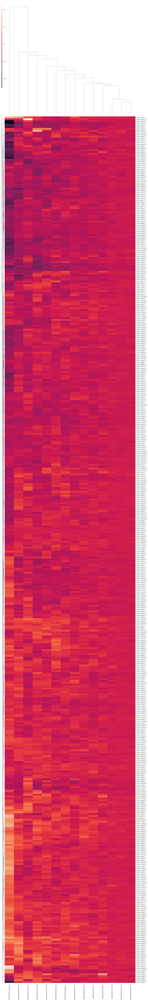

In [71]:
# sns.set(rc={'figure.figsize':(20,500)})
# plt.subplots(figsize=(20,15))
sns.clustermap(expression_clustered_tophits[1:15].T, xticklabels=True, yticklabels=True, figsize=(20,150))
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

In [8]:
expression_clustered

,GTEX-QDVJ,GTEX-WL46,GTEX-1EH9U,GTEX-WOFM,GTEX-1E1VI,GTEX-1CB4J,GTEX-WRHU,GTEX-1CB4H,GTEX-WVLH,GTEX-1CB4F,...,GTEX-XMK1,GTEX-1MJK3,GTEX-ZT9X,GTEX-ZP4G,GTEX-1K9T9,GTEX-1GMRU,GTEX-1QPFJ,GTEX-1F5PK,GTEX-1B97I,GTEX-T6MO
id,,,,,,,,,,,,,,,,,,,,,
ENSG00000186092.4,0.471546,-0.032765,-0.162684,-0.052664,-0.066083,-0.015764,-0.026927,0.027550,0.002474,-0.024224,...,-0.023045,0.005468,-0.038489,0.002112,-0.062213,-0.181355,0.016413,-0.109867,0.016214,-0.022456
ENSG00000187634.11,-3.334987,4.129838,-1.838517,-4.033845,3.062116,0.457174,1.421559,-2.691070,1.147211,-4.255807,...,-0.765203,3.200464,2.186642,-2.393644,-1.841619,0.611100,4.830514,-0.403501,0.966394,1.820704
ENSG00000188976.10,-1.330643,-0.263477,-3.668236,2.033417,-1.008865,-0.167236,5.204994,-11.358131,2.665657,-3.357666,...,0.036842,-3.913040,6.100864,3.195007,-1.706261,7.947327,1.393341,4.928856,0.321136,0.982872
ENSG00000187961.13,-1.011835,0.220661,0.379313,1.050967,-0.429187,-1.609584,-1.067303,-2.088532,-0.867061,2.452296,...,-1.699605,0.638956,2.726155,0.436669,-3.629027,0.188134,-0.303024,0.408571,-1.948196,-0.468409
ENSG00000187583.10,1.298513,-0.214591,-0.208705,0.000083,0.033299,-0.010006,-0.066634,0.118889,-0.138235,-0.044007,...,-0.070432,-0.169503,0.142848,-0.028148,0.140724,0.300204,0.312283,0.043918,-0.203731,-0.142826
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000212907.2,11698.788086,11199.039062,16478.791016,9278.864258,10778.934570,10228.849609,11808.856445,22628.769531,10389.106445,12109.036133,...,11778.958984,10988.852539,10359.082031,12048.955078,14918.912109,8328.778320,12928.900391,6758.877930,13718.829102,9838.712891
ENSG00000198886.2,30533.750000,29883.916016,31533.847656,25393.859375,21303.925781,21033.826172,29683.904297,43833.828125,23973.945312,25113.953125,...,34363.914062,23463.839844,25883.916016,27323.867188,27643.896484,17333.896484,23823.837891,16413.841797,27013.863281,31233.804688
ENSG00000198786.2,1722.449219,826.923340,4457.505859,3602.243408,2271.411621,2053.341309,-241.654541,4907.205078,918.818359,1393.155762,...,3427.962646,3751.268066,2211.636963,1969.538818,3444.460449,1112.641357,750.966309,915.927734,707.520752,3156.670898


In [25]:
expression_clustered_tophits[:1]

,GTEX-QDVJ,GTEX-WL46,GTEX-1EH9U,GTEX-WOFM,GTEX-1E1VI,GTEX-1CB4J,GTEX-WRHU,GTEX-1CB4H,GTEX-WVLH,GTEX-1CB4F,...,GTEX-XMK1,GTEX-1MJK3,GTEX-ZT9X,GTEX-ZP4G,GTEX-1K9T9,GTEX-1GMRU,GTEX-1QPFJ,GTEX-1F5PK,GTEX-1B97I,GTEX-T6MO
ENSG00000198938.2,24827.316406,30867.408203,27767.560547,21797.658203,20387.542969,27547.464844,21087.537109,39007.53125,21317.421875,23387.529297,...,25837.509766,13067.496094,15087.448242,21337.511719,21287.552734,14707.546875,21497.457031,18047.494141,22387.626953,20507.591797


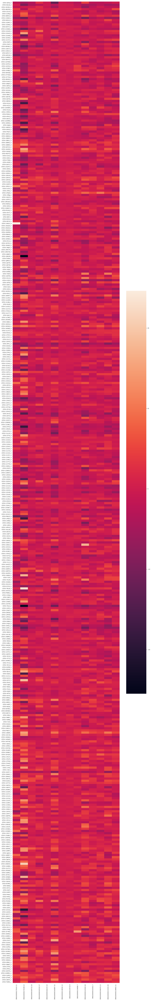

In [72]:
# sns.set(rc={'figure.figsize':(20,10)})
plt.subplots(figsize=(20,150))
sns.heatmap(expression_clustered_tophits[1:15].T, xticklabels=True, yticklabels=True)
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_heatmap_genotypelabel.pdf') 

In [104]:
expression_clustered_tophits

,GTEX-QDVJ_0,GTEX-WL46_0,GTEX-1EH9U_0,GTEX-WOFM_0,GTEX-1E1VI_0,GTEX-1CB4J_0,GTEX-WRHU_0,GTEX-1CB4H_0,GTEX-WVLH_0,GTEX-1CB4F_0,...,GTEX-XMK1_2,GTEX-1MJK3_2,GTEX-ZT9X_2,GTEX-ZP4G_2,GTEX-1K9T9_2,GTEX-1GMRU_2,GTEX-1QPFJ_2,GTEX-1F5PK_2,GTEX-1B97I_2,GTEX-T6MO_2
ENSG00000198938.2,43.446856,51.518532,48.556588,46.499280,47.826451,57.884939,47.206902,50.444414,48.799330,46.214519,...,42.274206,30.029519,33.088949,40.732782,41.346482,43.066333,47.489321,47.084017,48.431421,37.547606
ENSG00000179163.11,-0.026965,-0.022040,-0.025310,-0.025336,-0.025810,-0.028591,-0.032055,-0.027738,-0.031630,-0.032134,...,-0.018925,-0.027308,-0.025978,-0.027473,-0.021760,-0.030575,-0.024187,-0.029588,-0.031867,-0.025149
ENSG00000170248.13,-0.032265,-0.038843,-0.022961,-0.040901,-0.020820,-0.015117,-0.015370,-0.033257,-0.032132,-0.035274,...,-0.019215,-0.023959,-0.012381,-0.021894,-0.036968,-0.019099,-0.027189,-0.016204,-0.023262,-0.013967
ENSG00000185722.16,-0.028861,-0.029566,-0.022064,-0.027556,-0.026208,-0.034302,-0.024251,-0.020581,-0.031195,-0.023450,...,-0.026232,-0.035468,-0.024386,-0.025153,-0.024793,-0.030788,-0.029225,-0.028254,-0.029135,-0.030599
ENSG00000165322.17,-0.018506,-0.026785,-0.018046,-0.030091,-0.020246,-0.033298,-0.028378,-0.026243,-0.034819,-0.027957,...,-0.023482,-0.029575,-0.031600,-0.021132,-0.015021,-0.029734,-0.025512,-0.032150,-0.032283,-0.021553
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000130348.11,-0.024432,-0.022191,-0.021888,-0.029469,-0.024889,-0.033185,-0.027529,-0.018732,-0.027823,-0.028611,...,-0.024195,-0.040518,-0.026997,-0.028599,-0.020994,-0.028840,-0.031556,-0.038506,-0.023793,-0.026292
ENSG00000174915.11,-0.029577,-0.022981,-0.028441,-0.035014,-0.028079,-0.029728,-0.032172,-0.025718,-0.032854,-0.027396,...,-0.030907,-0.030958,-0.031653,-0.025319,-0.036769,-0.024976,-0.032089,-0.029676,-0.025412,-0.027615
ENSG00000122008.15,-0.025106,-0.021722,-0.023104,-0.029788,-0.024920,-0.028568,-0.028058,-0.020773,-0.030209,-0.025158,...,-0.024236,-0.034446,-0.027564,-0.025238,-0.025669,-0.029805,-0.034579,-0.035636,-0.028693,-0.028439
ENSG00000225697.12,-0.025796,-0.029358,-0.021046,-0.024949,-0.026083,-0.032138,-0.034827,-0.022701,-0.031869,-0.021694,...,-0.029105,-0.034057,-0.019187,-0.027565,-0.032165,-0.025542,-0.038021,0.058042,-0.028833,-0.027683


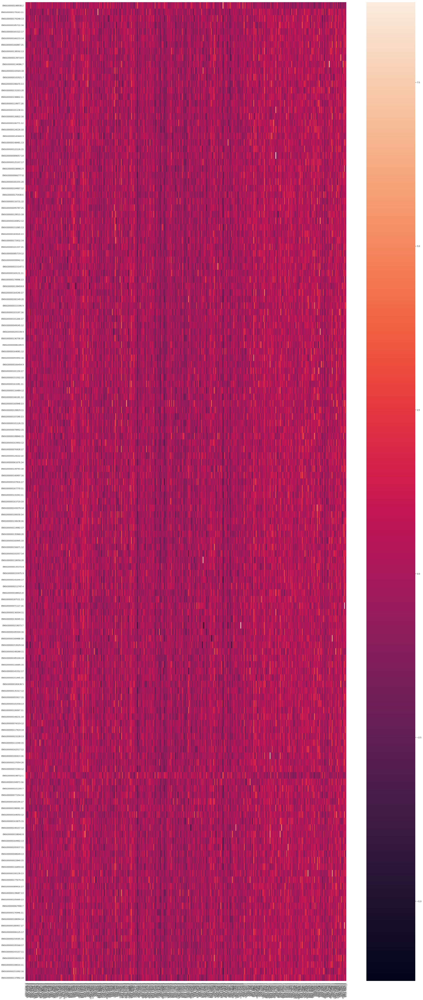

In [36]:
sns.set(rc={'figure.figsize':(40,100)})
# plt.subplots(figsize=(20,150))
# plt.subplots(figsize=(100,20))

sns.heatmap(expression_clustered_tophits[:150], xticklabels=True, yticklabels=True)
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_heatmap_genotypelabel.pdf') 

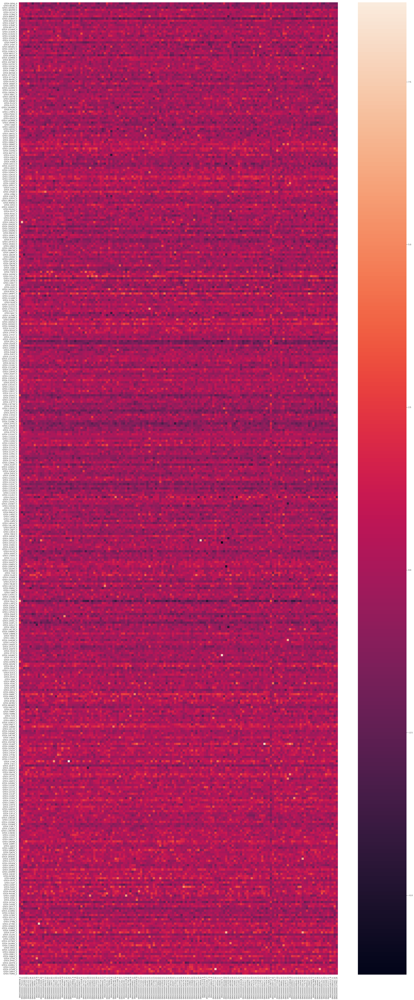

In [117]:
sns.set(rc={'figure.figsize':(40,100)})
# plt.subplots(figsize=(20,150))
# plt.subplots(figsize=(100,20))

sns.heatmap(expression_clustered_tophits[:150].T, xticklabels=True, yticklabels=True)
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_heatmap_genotypelabel.pdf') 

In [94]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

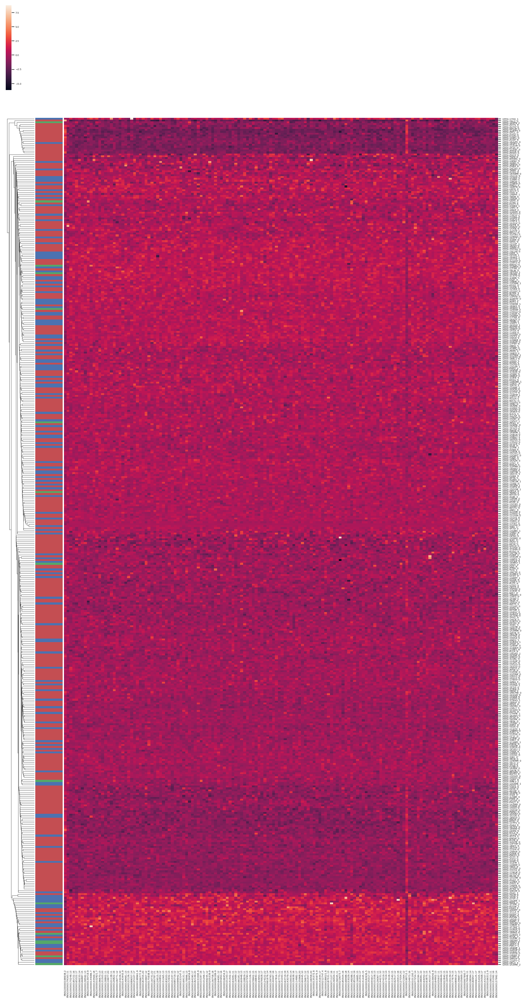

In [41]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=0.5)
sns.clustermap(expression_clustered_tophits[:150].T, xticklabels=True, yticklabels=True, col_cluster=False, row_cluster=True, row_colors=[color_rows], figsize=(20,40))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

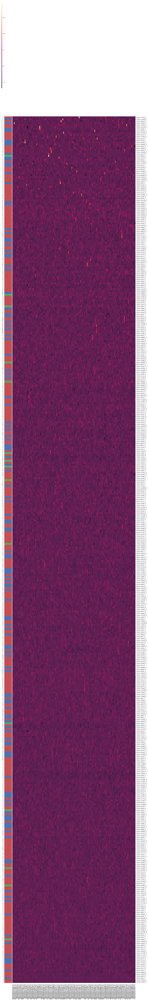

In [38]:
sns.clustermap(expression_clustered_nullhits[:150].T, xticklabels=True, yticklabels=True, col_cluster=False, row_cluster=True, row_colors=[color_rows], figsize=(20,150))
plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_nulltargets_genotypelabel.pdf') 

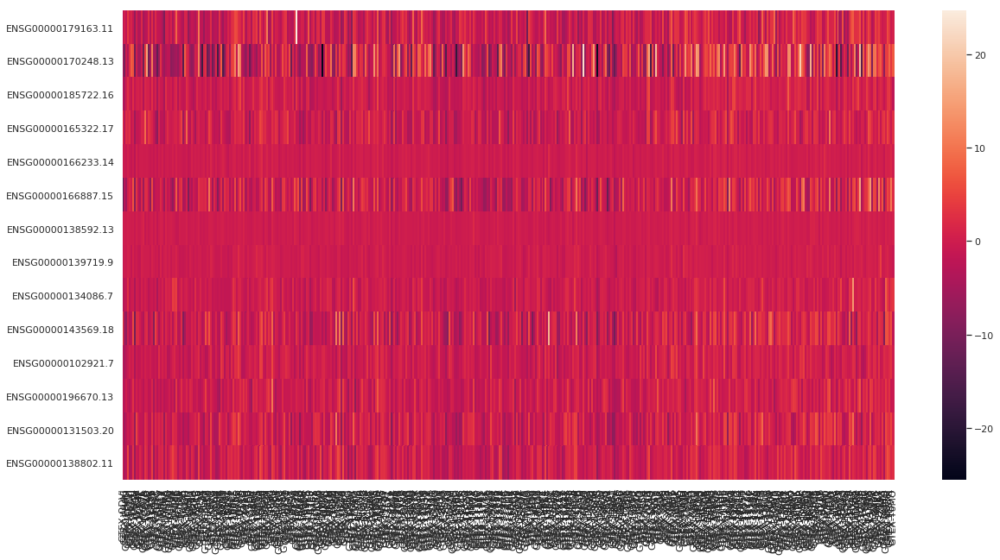

In [33]:
sns.set(rc={'figure.figsize':(20,10)})
sns.heatmap(expression_clustered_tophits[1:15], xticklabels=True, yticklabels=True)
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')


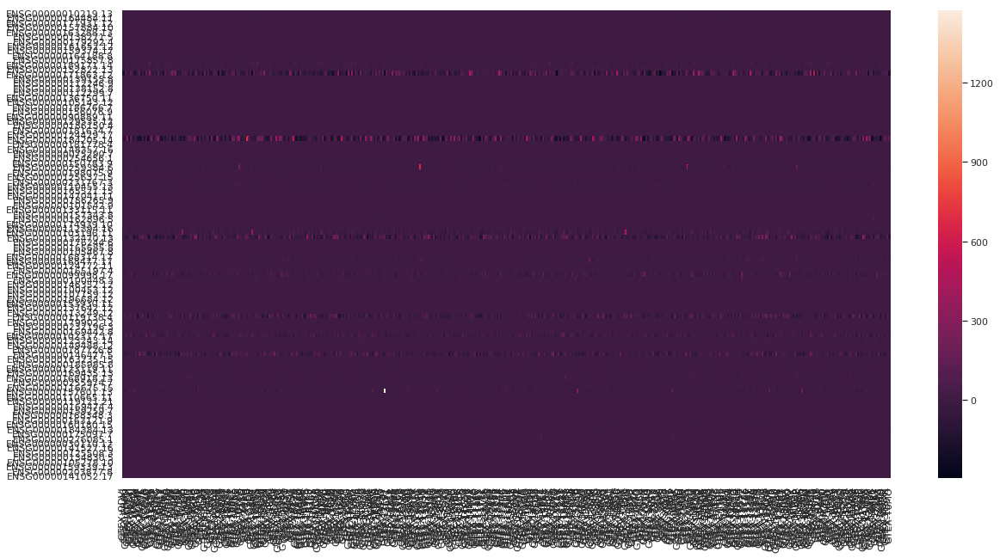

In [31]:
sns.set(rc={'figure.figsize':(20,10)})
sns.heatmap(expression_clustered_nullhits[:100], xticklabels=True, yticklabels=True)
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')


In [68]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits_geno0[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

In [69]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits_geno1[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

In [70]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits_geno2[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
# plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_clustermap_genotypelabel.pdf') 

In [75]:
sns.set(font_scale=5)

clustergrid = sns.clustermap(expression_clustered_tophits_geno2[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(150,150))

clustergrid.dendrogram_col.reordered_ind

[12, 8, 3, 14, 0, 1, 4, 10, 11, 6, 13, 9, 7, 2, 5]

In [76]:
clustergrid.dendrogram_col.reordered_ind

[12, 8, 3, 14, 0, 1, 4, 10, 11, 6, 13, 9, 7, 2, 5]

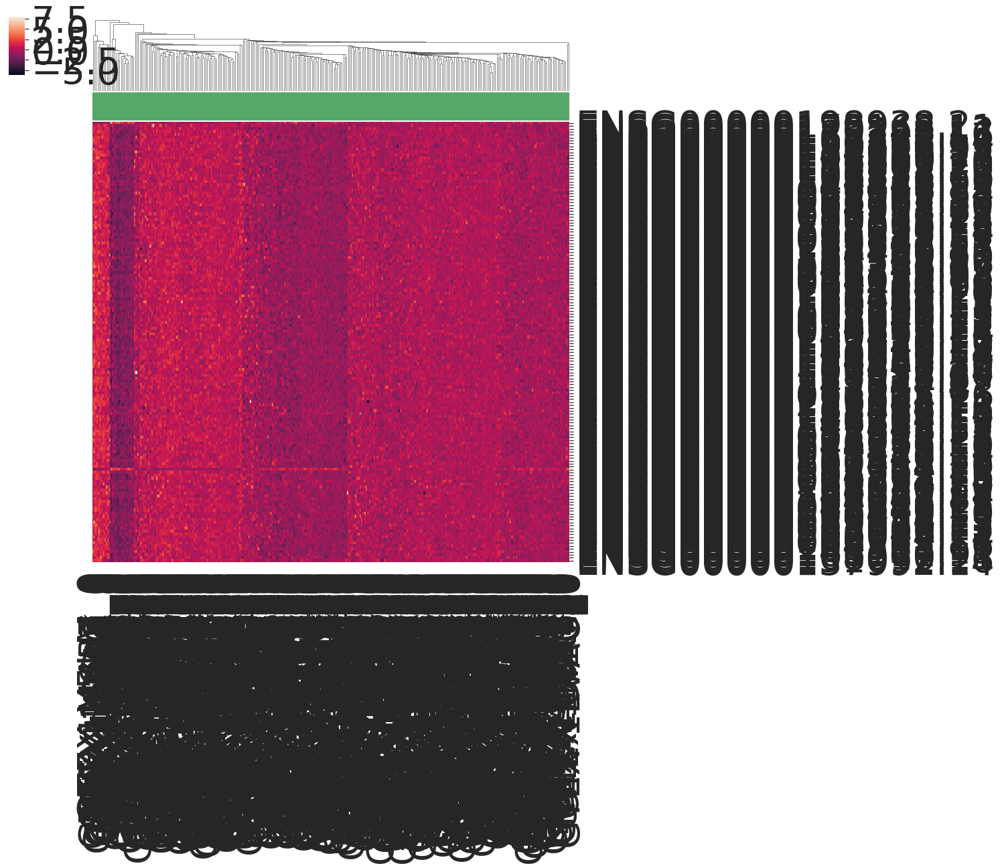

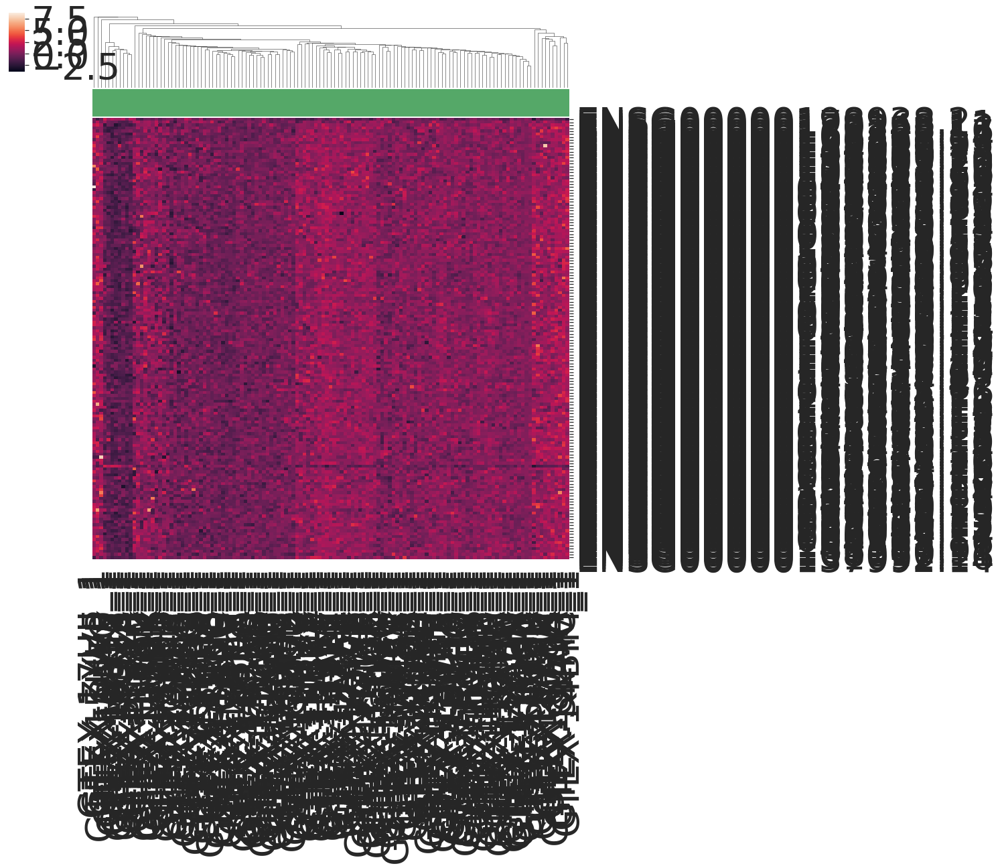

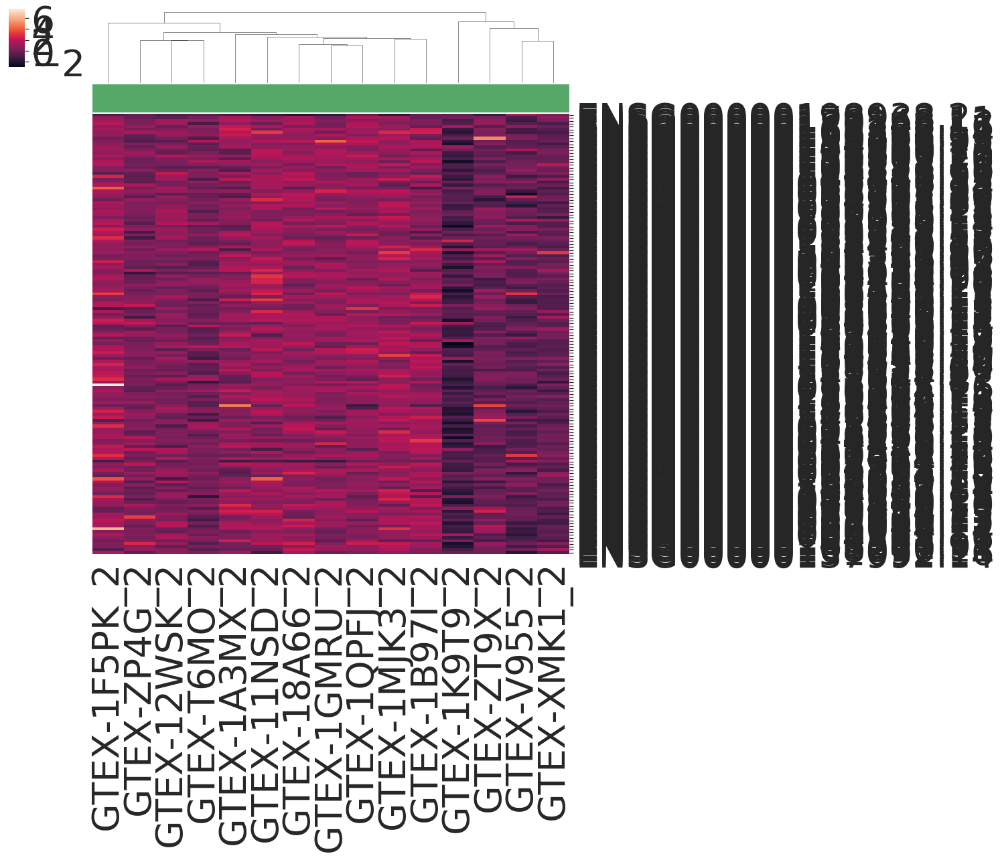

In [81]:
clustergrid = sns.clustermap(expression_clustered_tophits_geno0[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(15,15))
geno0_index = expression_clustered_tophits_geno0.columns[clustergrid.dendrogram_col.reordered_ind]

clustergrid = sns.clustermap(expression_clustered_tophits_geno1[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(15,15))
geno1_index = expression_clustered_tophits_geno1.columns[clustergrid.dendrogram_col.reordered_ind]

clustergrid = sns.clustermap(expression_clustered_tophits_geno2[:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=True, col_colors=[color_rows], figsize=(15,15))
geno2_index = expression_clustered_tophits_geno2.columns[clustergrid.dendrogram_col.reordered_ind]

In [88]:
geno1_index

Index(['GTEX-17HII_1', 'GTEX-ZYVF_1', 'GTEX-15UKP_1', 'GTEX-QVJO_1',
       'GTEX-WEY5_1', 'GTEX-183FY_1', 'GTEX-1ICG6_1', 'GTEX-1B933_1',
       'GTEX-XOT4_1', 'GTEX-1E2YA_1',
       ...
       'GTEX-NPJ8_1', 'GTEX-P44H_1', 'GTEX-PVOW_1', 'GTEX-1F7RK_1',
       'GTEX-WYJK_1', 'GTEX-QEL4_1', 'GTEX-18D9A_1', 'GTEX-Q2AG_1',
       'GTEX-SNMC_1', 'GTEX-14BIM_1'],
      dtype='object', length=129)

In [89]:
clustered_geno_columns = list(geno0_index) + list(geno1_index) + list(geno2_index)

In [90]:
expression_clustered_tophits[clustered_geno_columns]

,GTEX-Y5LM_0,GTEX-1M4P7_0,GTEX-1ICLZ_0,GTEX-1PDJ9_0,GTEX-1KD4Q_0,GTEX-1AX9K_0,GTEX-1QP28_0,GTEX-1QP29_0,GTEX-14E6E_0,GTEX-1B8KE_0,...,GTEX-11NSD_2,GTEX-18A66_2,GTEX-1GMRU_2,GTEX-1QPFJ_2,GTEX-1MJK3_2,GTEX-1B97I_2,GTEX-1K9T9_2,GTEX-ZT9X_2,GTEX-V955_2,GTEX-XMK1_2
ENSG00000198938.2,-0.113416,-2.317106,0.344636,-1.652081,-1.049837,-1.865824,-1.149918,-1.375548,-0.963326,0.236073,...,-1.460382,-1.913337,-1.460379,-0.308496,-1.738607,-0.157482,-0.344105,-1.395930,1.552537,0.427778
ENSG00000179163.11,0.397587,1.036316,0.326367,1.365065,1.982660,0.724234,0.139236,1.512759,2.536178,1.648206,...,0.620562,1.353319,0.135746,1.606918,1.294009,-0.118499,0.090003,0.342875,-0.958852,0.712643
ENSG00000170248.13,0.205495,1.676912,0.711616,0.371217,1.320337,2.140862,0.936082,-0.364641,0.906146,1.611552,...,1.200165,1.403041,0.604059,0.601173,0.834057,0.487536,-1.030427,1.018354,-1.270599,0.324910
ENSG00000185722.16,1.130759,1.773208,0.242503,1.556497,2.654348,1.400914,1.988171,1.400120,1.468305,1.183075,...,-0.101842,1.634942,0.202648,1.698307,0.527665,0.412115,-0.607972,0.957122,-0.627897,-0.941302
ENSG00000165322.17,-0.430712,0.538234,1.542349,0.978984,0.946888,0.549908,1.442491,1.848901,0.326835,0.989246,...,1.549960,0.380171,0.270921,1.803455,1.275836,-0.215855,1.329796,-0.469175,0.741832,-0.083778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000130348.11,1.645055,2.205787,0.976236,0.664408,1.701325,-0.539958,-0.043371,0.833028,0.995094,1.912637,...,0.788552,-0.767413,0.848548,1.895000,-0.882979,2.606011,0.563734,0.598805,1.263738,-0.531359
ENSG00000174915.11,-0.030311,2.127290,0.892611,0.776912,2.799427,1.900917,0.759262,1.177129,1.803945,0.055555,...,2.368060,1.896442,0.934330,0.843935,1.183348,0.998109,-2.885587,-0.530422,0.651041,-1.861048
ENSG00000122008.15,0.847824,2.129937,2.930480,2.084614,1.629165,0.055970,1.929446,1.068393,0.129273,1.113249,...,0.573458,0.627181,0.583570,0.809631,1.185293,0.814495,-1.319254,0.391562,0.257227,-0.545729
ENSG00000225697.12,-0.242874,1.048997,0.078404,0.868167,-0.223951,-0.550635,0.392939,0.580480,1.244115,0.099517,...,0.656103,0.540780,0.631154,-0.148615,0.483639,0.280522,-1.441567,1.237320,3.016752,-1.052202


In [93]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits[clustered_geno_columns][:150], xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_heatmap_genotypelabel.pdf') 

In [95]:
# sns.set(rc={'figure.figsize':(40,100)})
# sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale=1.5)
sns.clustermap(expression_clustered_tophits[clustered_geno_columns][:150], z_score=0, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, col_colors=[color_rows], figsize=(150,150))
# .set_title('Power for Mixture Model with gamma')
# plt.xlabel('# Target Genes')
# plt.ylabel('Beta effect size')
plt.savefig('/storage/cynthiawu/trans_eQTL/Scripts/Plots/chr7_45109068_heatmap_genotypelabel.pdf') 

## cis eqtl covariates

In [46]:
chr7_pairwise_matrix

,SNP,ENSG00000000003.14,ENSG00000000005.5,ENSG00000000419.12,ENSG00000000457.13,ENSG00000000460.16,ENSG00000000938.12,ENSG00000000971.15,ENSG00000001036.13,ENSG00000001084.10,...,ENSG00000283654.1,ENSG00000283755.1,ENSG00000283787.1,ENSG00000283886.1,ENSG00000283992.1,ENSG00000284024.1,ENSG00000284308.1,ENSG00000284395.1,ENSG00000284484.1,ENSG00000284526.1
0,chr7_100057066,0.232775,0.322748,0.931591,0.455460,0.787972,0.997467,0.409428,0.939127,0.947087,...,0.760301,0.797538,0.885911,0.625907,0.407418,0.989303,0.339464,0.873613,0.641905,0.371179
1,chr7_100095455,0.449856,0.384021,0.583097,0.502363,0.680698,0.688263,0.727162,0.805321,0.487579,...,0.417331,0.954638,0.436995,0.751554,0.461634,0.782837,0.159001,0.829188,0.496784,0.821070
2,chr7_100099174,0.298258,0.075398,0.441005,0.939695,0.977650,0.775315,0.537365,0.327884,0.364709,...,0.413470,0.033283,0.440814,0.049807,0.762906,0.008083,0.746540,0.330624,0.432471,0.303805
3,chr7_100105324,0.991336,0.000284,0.544864,0.587714,0.321153,0.203479,0.095757,0.017480,0.831420,...,0.887711,0.304736,0.133604,0.309138,0.193702,0.075928,0.810551,0.187966,0.956809,0.719433
4,chr7_100149507,0.918956,0.010762,0.526695,0.533091,0.499655,0.946964,0.714288,0.283712,0.711782,...,0.193212,0.020237,0.377773,0.495752,0.557392,0.002340,0.203357,0.289409,0.477164,0.568261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1117,chr7_99876804,0.430564,0.133172,0.273312,0.183789,0.574891,0.487192,0.622350,0.783821,0.622612,...,0.347712,0.540847,0.952820,0.236970,0.835945,0.402649,0.569226,0.166907,0.652402,0.235044
1118,chr7_99892567,0.344044,0.385599,0.996593,0.384274,0.313254,0.434567,0.630400,0.229298,0.408165,...,0.476577,0.556029,0.708559,0.847644,0.726112,0.934358,0.783814,0.032472,0.504315,0.332816
1119,chr7_99903276,0.422889,0.492172,0.053001,0.741340,0.814448,0.508489,0.416032,0.097851,0.390850,...,0.870125,0.363463,0.662264,0.200518,0.721867,0.616556,0.448917,0.262095,0.995646,0.130524
1120,chr7_99903288,0.675323,0.515702,0.276588,0.467308,0.765093,0.600690,0.994696,0.339762,0.594693,...,0.608072,0.741410,0.952681,0.241556,0.735498,0.630546,0.654651,0.851278,0.478490,0.051084


In [47]:
chr7_pairwise_matrix[chr7_pairwise_matrix['SNP']=='chr1_23868408']

,SNP,ENSG00000000003.14,ENSG00000000005.5,ENSG00000000419.12,ENSG00000000457.13,ENSG00000000460.16,ENSG00000000938.12,ENSG00000000971.15,ENSG00000001036.13,ENSG00000001084.10,...,ENSG00000283654.1,ENSG00000283755.1,ENSG00000283787.1,ENSG00000283886.1,ENSG00000283992.1,ENSG00000284024.1,ENSG00000284308.1,ENSG00000284395.1,ENSG00000284484.1,ENSG00000284526.1


In [50]:
genotype

,id,GTEX-111CU,GTEX-111FC,GTEX-111VG,GTEX-111YS,GTEX-1192X,GTEX-11DXX,GTEX-11EI6,GTEX-11EQ9,GTEX-11GS4,...,GTEX-ZVE2,GTEX-ZVT3,GTEX-ZVZP,GTEX-ZXES,GTEX-ZXG5,GTEX-ZYFD,GTEX-ZYFG,GTEX-ZYT6,GTEX-ZYVF,GTEX-ZZ64
0,chr7_246436,0,0,1,1,1,1,0,0,0,...,0,1,2,0,0,1,1,0,0,0
1,chr7_259884,0,0,0,0,0,0,1,1,2,...,2,1,0,2,0,0,1,2,1,1
2,chr7_259974,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,1,0,0,0
3,chr7_291120,0,0,2,1,2,1,1,0,2,...,1,2,0,0,1,1,2,2,1,1
4,chr7_291253,0,0,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1117,chr7_158879928,0,1,1,1,0,0,1,1,1,...,2,2,0,0,0,0,1,0,1,1
1118,chr7_158922528,2,1,2,2,2,2,1,1,1,...,1,0,2,2,2,2,2,2,1,1
1119,chr7_158942122,1,0,1,1,0,1,0,0,0,...,1,0,0,0,0,0,0,0,0,0
1120,chr7_159034635,1,0,0,2,0,0,0,0,0,...,0,1,0,0,1,0,0,1,0,0


In [52]:
genotype_chr1 = pd.read_csv('/storage/polo/GTEx_v8_matrix_eQTL/run2_GTEx_v8_Euro_only_PEER/Nerve-Tibial_Euro/chr1_SNP_intersect.tsv', sep='\t')


In [53]:
genotype_chr1[genotype_chr1['id']=='chr1_23854472']

,id,GTEX-111CU,GTEX-111FC,GTEX-111VG,GTEX-111YS,GTEX-1192X,GTEX-11DXX,GTEX-11EI6,GTEX-11EQ9,GTEX-11GS4,...,GTEX-ZVE2,GTEX-ZVT3,GTEX-ZVZP,GTEX-ZXES,GTEX-ZXG5,GTEX-ZYFD,GTEX-ZYFG,GTEX-ZYT6,GTEX-ZYVF,GTEX-ZZ64
412,chr1_23854472,1,0,0,0,1,1,2,1,2,...,0,0,1,2,1,0,1,0,0,1


In [54]:
chr7_covariates = pd.read_csv('/storage/cynthiawu/trans_eQTL/GTex.v8/Run2_031621/Nerve_Tibial/chr7_ciseqtl_covariates/chr7_covariance_intersect.tsv', sep='\t')

In [55]:
chr7_covariates

,id,GTEX-111CU,GTEX-111FC,GTEX-111VG,GTEX-111YS,GTEX-1192X,GTEX-11DXX,GTEX-11EI6,GTEX-11EQ9,GTEX-11GS4,...,GTEX-ZVE2,GTEX-ZVT3,GTEX-ZVZP,GTEX-ZXES,GTEX-ZXG5,GTEX-ZYFD,GTEX-ZYFG,GTEX-ZYT6,GTEX-ZYVF,GTEX-ZZ64
0,SEX,1.0000,1.0000,1.0000,1.0000,1.0000,2.0000,1.0000,1.0000,1.0000,...,1.0000,2.0000,1.0000,2.0000,1.0000,1.0000,2.0000,1.0000,2.0000,1.0000
1,AGE,57.0000,61.0000,63.0000,62.0000,55.0000,66.0000,62.0000,33.0000,61.0000,...,59.0000,67.0000,58.0000,38.0000,66.0000,55.0000,67.0000,30.0000,54.0000,24.0000
2,PC1_178.652,-0.0002,-0.0018,-0.0008,0.0020,-0.0009,-0.0006,0.0012,-0.0015,-0.0004,...,-0.0002,-0.0006,-0.0010,0.0028,-0.0031,0.0017,0.0034,-0.0003,-0.0015,0.0009
3,PC2_119.536,0.0235,0.0245,0.0238,0.0252,0.0226,0.0246,0.0225,0.0250,0.0211,...,0.0275,0.0268,0.0256,0.0197,0.0191,0.0241,0.0234,0.0234,0.0237,0.0223
4,PC3_31.844,-0.0056,-0.0029,-0.0051,0.0045,-0.0093,-0.0045,-0.0022,-0.0083,-0.0063,...,-0.0135,-0.0116,-0.0063,-0.0026,-0.0107,0.0020,-0.0064,-0.0069,-0.0095,0.0028
5,PC4_11.937,0.0159,0.0158,0.0049,0.0129,0.0114,0.0112,0.0003,0.0113,-0.0088,...,0.0102,0.0172,0.0072,-0.0140,0.0003,0.0095,-0.0005,0.0055,0.0016,-0.0141
6,PC5_7.826,0.0065,0.0030,-0.0441,-0.0049,-0.0047,0.0184,0.0167,-0.0061,-0.0275,...,0.0332,0.0176,0.0110,0.0272,0.0101,0.0232,0.0209,0.0066,-0.0114,0.0185
7,PC6_7.463,-0.0123,-0.0072,0.0225,-0.0057,0.0111,-0.0088,-0.0290,0.0200,0.0057,...,-0.0032,0.0118,-0.0226,-0.0597,0.0201,-0.0230,-0.0200,-0.0222,-0.0181,-0.0067
8,PC7_6.971,-0.0027,-0.0076,0.0035,-0.0092,0.0019,-0.0098,-0.0225,0.0243,0.0045,...,0.0008,0.0248,-0.0162,-0.0104,0.0106,-0.0189,-0.0003,-0.0263,0.0038,0.0153
9,PC8_6.877,0.0136,-0.0366,-0.0069,0.0371,0.0224,-0.0048,-0.0212,-0.0306,-0.0111,...,-0.0059,-0.0148,-0.0097,0.0132,-0.0051,-0.0097,-0.0092,-0.0033,-0.0054,-0.0088


In [56]:
ciseqtl_cov = genotype_chr1[genotype_chr1['id']=='chr1_23854472']

In [59]:
chr7_covariates_ciseqtl = chr7_covariates.append(ciseqtl_cov)

In [62]:
chr7_covariates_ciseqtl.to_csv('/storage/cynthiawu/trans_eQTL/GTex.v8/Run2_031621/Nerve_Tibial/chr7_ciseqtl_covariates/chr7_covariance_intersect_ciseqtl.tsv', sep='\t', index=False)